In [1]:
import torch

import torchvision
import torchinfo
import tqdm.notebook

tqdm = tqdm.notebook

In [2]:
torch.cuda.is_available()

True

In [3]:

nn = torch.nn
F = torch.nn.functional

---
## Load Dataset


In [4]:
class AddNoise():
    def __init__(self):
        return
    def __call__(self, image):
        # as a torch tensor!
        rnd = 0.01 * torch.rand(image.shape)
        return image + rnd

In [5]:
ds = torchvision.datasets.LFWPeople(root="data", download=True, 
                                    transform=torchvision.transforms.Compose([
                                        torchvision.transforms.ToTensor(),
                                        torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                        AddNoise()
                                    ]))

Files already downloaded and verified


---
## Change To custom Dataset

In [6]:
import pandas as pd
import numpy as np
df1 = pd.read_csv("data/lfw-py/peopleDevTrain.txt")
df2 = pd.read_csv("data/lfw-py/peopleDevTest.txt")

In [7]:
df = pd.DataFrame(df1['4038'].append(df2['1711']))

/tmp/ipykernel_30335/1424854506.py:1: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = pd.DataFrame(df1['4038'].append(df2['1711']))


In [8]:
df[['name','count']] = df[0].str.split('\t', 1 ,expand=True)


/tmp/ipykernel_30335/2571908048.py:1: FutureWarning: In a future version of pandas all arguments of StringMethods.split except for the argument 'pat' will be keyword-only.
  df[['name','count']] = df[0].str.split('\t', 1 ,expand=True)


In [9]:
df_new = df.drop(0, axis=1)

In [10]:
df_filtered = df_new[(df_new['count'].astype(int) > 20) & (df_new['count'].astype(int) < 300)]

In [11]:
df_filtered.reset_index().drop("index", axis=1).to_csv('data/lfw-py/mydata.csv')

In [12]:
df_fromfile = pd.read_csv('data/lfw-py/mydata.csv')

In [13]:
df_fromfile

,Unnamed: 0,name,count
0,0,Alejandro_Toledo,39
1,1,Andre_Agassi,36
2,2,Ariel_Sharon,77
3,3,Arnold_Schwarzenegger,42
4,4,Atal_Bihari_Vajpayee,24
5,5,Bill_Clinton,29
6,6,Carlos_Menem,21
7,7,Colin_Powell,236
8,8,David_Beckham,31
9,9,Gloria_Macapagal_Arroyo,44


In [14]:
df_fromfile['count'].sum()

2393

In [15]:
import imageio.v3 as iio
import os

class NewDataset(torch.utils.data.Dataset): 
    def __init__(self, transform=None):
        self.csv = pd.read_csv(f"data/lfw-py/mydata.csv")
        self.transform = transform
        d = []
        for i, tup in self.csv.iterrows():
            clsnum = i
            for j in range(1, int(tup['count'])+1):
                d.append({"img" : f"{tup['name']}/{tup['name']}_{j:04d}.jpg", "class" : clsnum})
        self.dataframe = pd.DataFrame(d)
        
    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        xs = self.dataframe.loc[idx, "img"]
        path_ = os.path.join("data/lfw-py/lfw_funneled", xs)
        img = iio.imread(path_)
        cls_ = self.dataframe.loc[idx, "class"]
        if self.transform:
            img = self.transform(img)
        return img, cls_
    def _get_classes(self):
        return len(self.csv)

In [16]:
dset = NewDataset(transform=torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
    AddNoise()
]))


In [17]:
len(dset)

2393

In [18]:
transforms = torchvision.transforms.Compose([
    torchvision.transforms.ToPILImage(),
    torchvision.transforms.AugMix(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

In [19]:
dset2 = NewDataset(transform=transforms)

In [20]:
len(dset2)

2393

---
## Model Definition

In [21]:
class CGDFeatures(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        _mac = F.adaptive_max_pool2d(x, (1, 1))
        _spoc = F.adaptive_avg_pool2d(x, (1, 1))
        _gem = F.lp_pool2d(F.threshold(x, 1e-6, 1e-6), 3, (x.size(-2), x.size(-1)))
        _mac = torch.squeeze(F.normalize(_mac, p=2, eps=1e-6))
        _spoc = torch.squeeze(F.normalize(_spoc, p=2, eps=1e-6))
        _gem = torch.squeeze(F.normalize(_gem, p=2, eps=1e-6))
        return (_gem, torch.cat((_gem, _spoc, _mac), dim=1))

In [22]:
class ds_conv(nn.Module):
    def __init__(self, c_in, c_out, kersz=3, pad=0, strides=1, dilations=1, bias=True):
        super().__init__()
        self.depthwise = nn.Conv2d(c_in, c_in, kernel_size=kersz, padding=pad, stride=strides, dilation=dilations, groups=c_in, bias=bias)
        self.pointwise = nn.Conv2d(c_in, c_out, kernel_size=1, bias=bias)
    def forward(self, x):
        out = self.depthwise(x)
        out = self.pointwise(out)
        return out

In [23]:
class Block(nn.Module):
    def __init__(self, c_in, c_out, strides=False):
        super().__init__()
        self.relu6 = nn.ReLU6()
        #self.bn1 = nn.LazyBatchNorm2d()
        #self.bn2 = nn.LazyBatchNorm2d()
        #self.bn3 = nn.LazyBatchNorm2d()
        self.conv1 = ds_conv(c_in, c_out, pad=1, strides=2) if strides else ds_conv(c_in, c_out, pad=1)
        self.conv2 = ds_conv(c_out, c_out, pad=1)
        self.downsample = ds_conv(c_in, c_out, kersz=1, pad=0, strides=2, bias=False) if strides else ds_conv(c_in, c_out, kersz=1, pad=0, strides=1, bias=False)
    def forward(self, x):
        out = self.conv1(x)
        #out = self.bn1(out)
        out = self.relu6(out)
        out = self.conv2(out)
        #out = self.bn2(out)
        out = self.relu6(out)
        identity = self.downsample(x)
        #identity = self.bn3(identity)
        out += identity
        out = self.relu6(out)
        return out

In [24]:
import math
class ArcFaceTail(nn.Module):
    def __init__(self, in_features, out_features, s=30.0, m=0.50, easy_margin=False):
        super().__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.s = s
        self.m = m
        self.weight = nn.Parameter(torch.FloatTensor(out_features, in_features))
        nn.init.xavier_uniform_(self.weight)

        self.easy_margin = easy_margin
        self.cos_m = math.cos(m)
        self.sin_m = math.sin(m)
        self.th = math.cos(math.pi - m)
        self.mm = math.sin(math.pi - m) * m

    def forward(self, x, label=None):
        cosine = F.linear(F.normalize(x), F.normalize(self.weight))
        if label is not None:
            sine = torch.sqrt((1.0 - torch.pow(cosine, 2)).clamp(0, 1))
            phi = cosine * self.cos_m - sine * self.sin_m
            if self.easy_margin:
                phi = torch.where(cosine > 0, phi, cosine)
            else:
                phi = torch.where(cosine > self.th, phi, cosine - self.mm)
            one_hot = torch.zeros(cosine.size(), device='cuda')
            one_hot.scatter_(1, label.view(-1, 1).long(), 1)
            output = (one_hot * phi) + ((1.0 - one_hot) * cosine)
            output *= self.s
        else:
            output = cosine

        return output

In [25]:
class LambdaLayer(nn.Module):
    def __init__(self, lambd):
        super(LambdaLayer, self).__init__()
        self.lambd = lambd
    def forward(self, x):
        return self.lambd(x)

In [26]:
class GeM(nn.Module):
    def __init__(self):
        super().__init__()
        self.amap = nn.AdaptiveAvgPool2d((1,1))
    def forward(self, x):
        out = torch.pow(x, 3)
        out = self.amap(out)
        out = torch.pow(out, 1. / 3.)
        out = F.relu6(out)
        self.int = out
        return out

In [27]:
class Resnet_Arcface(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.conv1 = ds_conv(3, 64, kersz=7, pad=3, strides=2)
        self.relu6 = nn.ReLU6()
        self.feat = GeM()
        self.flat = nn.Flatten()
        self.maxpool2d = nn.MaxPool2d(2,2)
        self.block1_1 = Block(64, 64)
        self.block1_2 = Block(64, 64)
        self.block2_1 = Block(64, 128, strides=True)
        self.block2_2 = Block(128, 128)
        self.block3_1 = Block(128, 256, strides=True)
        self.block3_2 = Block(256, 256)
        self.block4_1 = Block(256, 512, strides=True)
        self.block4_2 = Block(512, 512)
        self.arcface = ArcFaceTail(512, num_classes)
    def forward(self, x, label=None):
        out = self.conv1(x)
        out = self.relu6(out)
        out = self.maxpool2d(out)
        out = self.block1_1(out)
        out = self.block1_2(out)
        out = self.block2_1(out)
        out = self.block2_2(out)
        out = self.block3_1(out)
        out = self.block3_2(out)
        out = self.block4_1(out)
        out = self.block4_2(out)
        out = self.feat(out)
        out = self.flat(out)
        out = self.arcface(out, label)
        return out

In [28]:
model = Resnet_Arcface(56)

torchinfo.summary(model, (64, 3, 250, 250))

Layer (type:depth-idx)                   Output Shape              Param #
Resnet_Arcface                           [64, 56]                  --
├─ds_conv: 1-1                           [64, 64, 125, 125]        --
│    └─Conv2d: 2-1                       [64, 3, 125, 125]         150
│    └─Conv2d: 2-2                       [64, 64, 125, 125]        256
├─ReLU6: 1-2                             [64, 64, 125, 125]        --
├─MaxPool2d: 1-3                         [64, 64, 62, 62]          --
├─Block: 1-4                             [64, 64, 62, 62]          --
│    └─ds_conv: 2-3                      [64, 64, 62, 62]          --
│    │    └─Conv2d: 3-1                  [64, 64, 62, 62]          640
│    │    └─Conv2d: 3-2                  [64, 64, 62, 62]          4,160
│    └─ReLU6: 2-4                        [64, 64, 62, 62]          --
│    └─ds_conv: 2-5                      [64, 64, 62, 62]          --
│    │    └─Conv2d: 3-3                  [64, 64, 62, 62]          640
│    │  

---
## Prepare Learning

In [29]:
model.train()

Resnet_Arcface(
  (conv1): ds_conv(
    (depthwise): Conv2d(3, 3, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=3)
    (pointwise): Conv2d(3, 64, kernel_size=(1, 1), stride=(1, 1))
  )
  (relu6): ReLU6()
  (feat): GeM(
    (amap): AdaptiveAvgPool2d(output_size=(1, 1))
  )
  (flat): Flatten(start_dim=1, end_dim=-1)
  (maxpool2d): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (block1_1): Block(
    (relu6): ReLU6()
    (conv1): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (conv2): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (downsample): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), groups=64, bias=False)
      (pointwise): Conv2d(64, 64, k

In [30]:
model.cuda()


Resnet_Arcface(
  (conv1): ds_conv(
    (depthwise): Conv2d(3, 3, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=3)
    (pointwise): Conv2d(3, 64, kernel_size=(1, 1), stride=(1, 1))
  )
  (relu6): ReLU6()
  (feat): GeM(
    (amap): AdaptiveAvgPool2d(output_size=(1, 1))
  )
  (flat): Flatten(start_dim=1, end_dim=-1)
  (maxpool2d): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (block1_1): Block(
    (relu6): ReLU6()
    (conv1): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (conv2): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (downsample): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), groups=64, bias=False)
      (pointwise): Conv2d(64, 64, k

In [31]:
criterion = torch.nn.CrossEntropyLoss(label_smoothing=0.1)
optimizer = torch.optim.RMSprop(params=model.parameters(),lr=1e-3)

In [32]:
from pytorch_metric_learning import losses, distances, miners
criterion2 = losses.TripletMarginLoss(distance=distances.CosineSimilarity())

In [33]:
miner = miners.BatchHardMiner(distance=distances.CosineSimilarity())

In [34]:
import opacus

In [35]:
newdset = torch.utils.data.ConcatDataset([dset, dset2])

In [36]:
delta = (1. / 2393.) * 0.5
privacy_engine = opacus.PrivacyEngine()
model_, optimizer_, data_loader_ = privacy_engine.make_private(
    module=model,
    optimizer=optimizer,
    data_loader=torch.utils.data.DataLoader(newdset, shuffle=True, batch_size=64),
    max_grad_norm=0.9,
    noise_multiplier=1.1
)

/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/opacus/privacy_engine.py:142: UserWarning: Secure RNG turned off. This is perfectly fine for experimentation as it allows for much faster training performance, but remember to turn it on and retrain one last time before production with ``secure_mode`` turned on.
  warnings.warn(
/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/_functorch/deprecated.py:97: UserWarning: We've integrated functorch into PyTorch. As the final step of the integration, functorch.make_functional is deprecated as of PyTorch 2.0 and will be deleted in a future version of PyTorch >= 2.3. Please use torch.func.functional_call instead; see the PyTorch 2.0 release notes and/or the torch.func migration guide for more details https://pytorch.org/docs/master/func.migrating.html
  warn_deprecated('make_functional', 'torch.func.functional_call')
/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/_functorch/deprec

In [37]:
torch.cuda.empty_cache()

In [38]:
optimizer_.param_groups[0]['lr'] = 1e-3

In [39]:
from collections import deque

epochs = tqdm.trange(1, 201)
loss_graph = []
for epoch in epochs:
    losses = deque([], maxlen=10)
    for batch in data_loader_:
        optimizer_.zero_grad()
        cx, cy = batch
        gx = cx.cuda(); gy = cy.cuda()
        pred = model_(gx,label=gy)
        embed = torch.squeeze(model_.feat.int)
        tuples = miner(embed, cy)
        loss = 4 * criterion(pred, gy) + 16 * criterion2(embed, cy, tuples)
        losses.append(loss.item())
        loss.backward()
        optimizer.step()
    lsiter = np.mean(list(losses))
    loss_graph.append(lsiter)
    epochs.set_description(f"ep:{epoch}, loss:{lsiter:.2f}")

  0%|          | 0/200 [00:00<?, ?it/s]

/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


<Axes: >

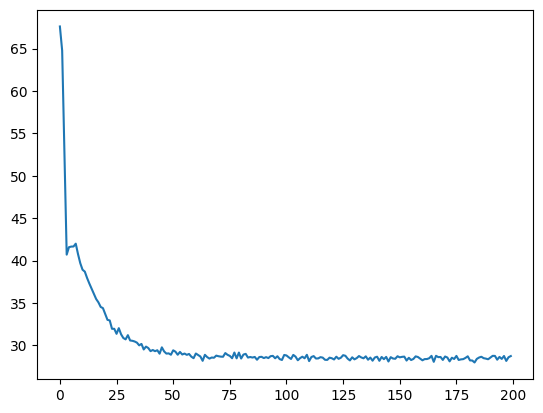

In [40]:
import seaborn as sns
sns.lineplot(loss_graph)

---
## Evaluation by original dataset:

In [62]:
model_.eval()

GradSampleModule(Resnet_Arcface(
  (conv1): ds_conv(
    (depthwise): Conv2d(3, 3, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=3)
    (pointwise): Conv2d(3, 64, kernel_size=(1, 1), stride=(1, 1))
  )
  (relu6): ReLU6()
  (feat): GeM(
    (amap): AdaptiveAvgPool2d(output_size=(1, 1))
  )
  (flat): Flatten(start_dim=1, end_dim=-1)
  (maxpool2d): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (block1_1): Block(
    (relu6): ReLU6()
    (conv1): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (conv2): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
      (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    )
    (downsample): ds_conv(
      (depthwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), groups=64, bias=False)
      (pointwise):

In [42]:
eval_cls = torch.utils.data.DataLoader(dset, shuffle=True, batch_size=1)

In [43]:
aggregate = {}
aggregate['true'] = []
aggregate['pred'] = []
for batch in tqdm.tqdm(eval_cls):
    x, y = batch
    res = model_(x.cuda())
    pred = torch.argmax(torch.exp(res))
    true = y
    aggregate['true'].append(int(true))
    aggregate['pred'].append(int(pred))

  0%|          | 0/2393 [00:00<?, ?it/s]

/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/nn/modules/module.py:1319: UserWarning: Using non-full backward hooks on a Module that does not take as input a single Tensor or a tuple of Tensors is deprecated and will be removed in future versions. This hook will be missing some of the grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using non-full backward hooks on a Module that does not take as input a "


In [44]:
from sklearn.metrics import accuracy_score 
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score 
from sklearn.metrics import confusion_matrix

In [45]:
confmatrix = confusion_matrix(aggregate['true'], aggregate['pred'])

<Axes: >

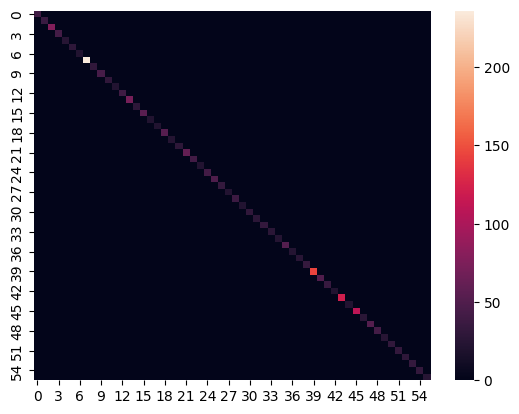

In [46]:
import seaborn as sns

sns.heatmap(confmatrix)

In [47]:
accuracy_score(aggregate['true'], aggregate['pred'])

1.0

---
## Evaluations by Pairs


In [48]:
evalData = torchvision.datasets.LFWPairs(root="data", download=True ,split='test',
                                    transform=torchvision.transforms.Compose([
                                        torchvision.transforms.ToTensor(),
                                        torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
                                    ]))

Files already downloaded and verified


In [49]:
eval_loader = torch.utils.data.DataLoader(evalData, shuffle=True, batch_size=1)

In [50]:
len(evalData)

1000

In [51]:
import math
agg = {'true': [], 'predicted': []}
for batch in tqdm.tqdm(eval_loader):
    x1, x2, y = batch
    model_(x1.cuda())
    fout1 = model_.feat.int
    model_(x2.cuda())
    fout2 = model_.feat.int
    norm_ = torch.dot(F.normalize(torch.squeeze(fout1), dim=0), F.normalize(torch.squeeze(fout2), dim=0))
    y_pred = 1 if norm_ > 0.97 else 0
    agg['true'].append(y)
    agg['predicted'].append(y_pred)
    

  0%|          | 0/1000 [00:00<?, ?it/s]

/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/home/yang/miniconda3/envs/tensorflow/lib/python3.9/site-packages/torch/nn/modules/module.py:1319: UserWarning: Using non-full backward hooks on a Module that does not take as input a single Tensor or a tuple of Tensors is deprecated and will be removed in future versions. This hook will be missing some of the grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using non-full backward hooks on a Module that does not take as input a "


In [52]:
agg['true'] = list(map(int, agg['true']))

In [53]:

accuracy_val = accuracy_score(agg['true'], agg['predicted'])
precision_val = precision_score(agg['true'], agg['predicted'])


print(accuracy_val, precision_val)


0.584 0.8962264150943396


accuracy | precision

In [54]:

print(recall_score(agg['true'], agg['predicted']))

0.19


In [55]:
confusion_matrix(agg['true'], agg['predicted'])

array([[489,  11],
       [405,  95]])

---
## Export AS ONNX!


In [67]:
import torch.onnx
import copy

In [78]:
! pip install onnx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 4.5 MB/s eta 0:00:0000:0100:01


In [79]:
torch.onnx.export(model_.cpu(), 
                  torch.randn(64, 3, 250, 250,),
                  "arcface.onnx",  
                  export_params=True,       
                  opset_version=10,          
                  do_constant_folding=True, 
                  input_names = ['input'],   
                  output_names = ['output'], 
                  dynamic_axes={'input' : {0 : 'batch_size'},  
                                'output' : {0 : 'batch_size'}})

============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



In [83]:
torch.onnx.export(model_.cpu(), 
                  torch.randn(64, 3, 250, 250,),
                  "arcface2.onnx",  
                  export_params=True,       
                  opset_version=10,          
                  do_constant_folding=True, 
                  input_names = ['input'],   
                  output_names = ['output'], )

============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



In [80]:
import onnx

onnx_model = onnx.load("arcface.onnx")

In [81]:
onnx.checker.check_model(onnx_model)

In [82]:
onnx_model.graph

node {
  input: "input"
  input: "_module.conv1.depthwise.weight"
  input: "_module.conv1.depthwise.bias"
  output: "/_module/conv1/depthwise/Conv_output_0"
  name: "/_module/conv1/depthwise/Conv"
  op_type: "Conv"
  attribute {
    name: "dilations"
    type: INTS
    ints: 1
    ints: 1
  }
  attribute {
    name: "group"
    type: INT
    i: 3
  }
  attribute {
    name: "kernel_shape"
    type: INTS
    ints: 7
    ints: 7
  }
  attribute {
    name: "pads"
    type: INTS
    ints: 3
    ints: 3
    ints: 3
    ints: 3
  }
  attribute {
    name: "strides"
    type: INTS
    ints: 2
    ints: 2
  }
}
node {
  input: "/_module/conv1/depthwise/Conv_output_0"
  input: "_module.conv1.pointwise.weight"
  input: "_module.conv1.pointwise.bias"
  output: "/_module/conv1/pointwise/Conv_output_0"
  name: "/_module/conv1/pointwise/Conv"
  op_type: "Conv"
  attribute {
    name: "dilations"
    type: INTS
    ints: 1
    ints: 1
  }
  attribute {
    name: "group"
    type: INT
    i: 1
  }
  

In [112]:
import onnxruntime

ortsess = onnxruntime.InferenceSession('onnx-modifier/modified_onnx/modified_modified_arcface2.onnx')

In [138]:
s1 = iio.imread('data/lfw-py/lfw_funneled/Ali_Naimi/Ali_Naimi_0001.jpg')
s2 = iio.imread('data/lfw-py/lfw_funneled/Ali_Naimi/Ali_Naimi_0001.jpg')
s3 = iio.imread('data/lfw-py/lfw_funneled/Ali_Naimi/Ali_Naimi_0001.jpg')
s4 = iio.imread('data/lfw-py/lfw_funneled/Ali_Naimi/Ali_Naimi_0001.jpg')
s5 = iio.imread('data/lfw-py/lfw_funneled/Ali_Naimi/Ali_Naimi_0001.jpg')
n1 = iio.imread('data/lfw-py/lfw_funneled/Alex_Wallau/Alex_Wallau_0001.jpg')

tr = torchvision.transforms.ToTensor()


x = ortsess.run([ortsess.get_outputs()[0].name], 
            {ortsess.get_inputs()[0].name: 
             np.array([tr(s1).numpy(), tr(s2).numpy(), tr(s3).numpy(), tr(s4).numpy(), tr(s5).numpy(), tr(n1).numpy()])})

In [140]:
x[0].shape

(6, 512)

In [137]:
from sklearn.metrics.pairwise import cosine_similarity

for i,j in zip(range(6), range(6)):
    if i == j: pass
    print(cosine_similarity([x[0][i]], [x[0][j]]))

[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.0000001]]


In [145]:
cosine_similarity([x[0][0]], [x[0][5]]) 

array([[0.94615275]], dtype=float32)